In [1]:
using Distributions, Plots
default(size=(800,600))

In [2]:
Na = 20#rand(Poisson(lambda_a*area_a))

xa = rand(Uniform(-1,1),Na,2)
xa = [[xa[i,1],xa[i,2]] for i in (1:Na)]

d(x,y) = sum(abs.(x-y)) #norma 1

d (generic function with 1 method)

In [3]:
function find_nearest(x,xa,d)
    Na=length(xa)
    distances = [d(x,xa_) for xa_ in xa]
    d0,attach = findmin(distances)
    return d0,attach
end

find_nearest (generic function with 1 method)

In [4]:
xc = [[x,y] for x in -1:.01:1, y in -1:.01:1][:]

Nc = length(xc)

attachs = zeros(Int64,Nc)

z = map(x->find_nearest(x,xa,d), xc)

attachs = [u[2] for u in z];

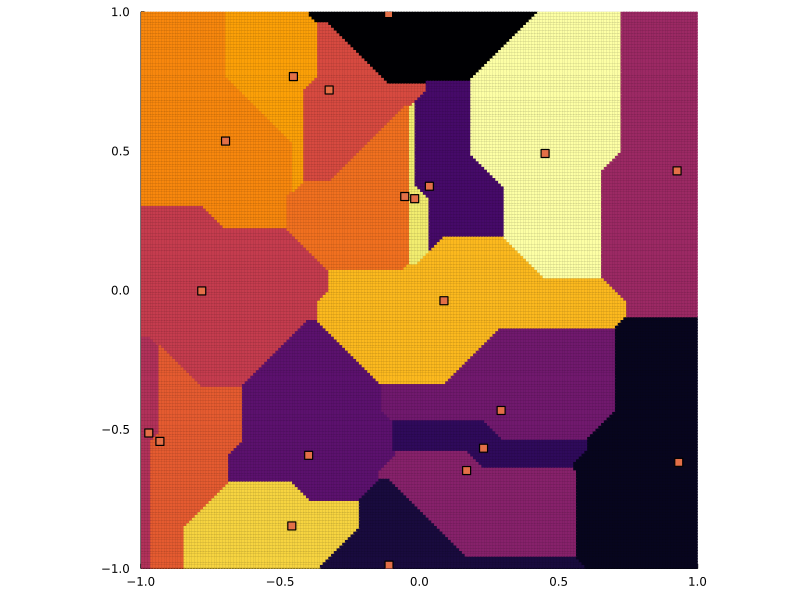

In [5]:
Xa = [xa[i][j] for i in 1:Na, j in 1:2]
Xc = [xc[i][j] for i in 1:length(xc), j in 1:2]

scatter(Xc[:,1],Xc[:,2], marker_z = attachs, marker=:square, markersize=2, markerstrokewidth=0 )
scatter!(Xa[:,1],Xa[:,2], xlims=(-1,1), ylims=(-1,1), aspectratio=:equal, marker=:square, legend=:none, colorbar=:none)


In [6]:
#savefig("voronoiL1.png")